# Packages

In [46]:
import pandas as pd
import kedro
from pandas_profiling import ProfileReport

# EDA

## Overview

In [1]:
%reload_kedro

[02/10/23 08:29:46] INFO     Resolved project path as:                                              ]8;id=239952;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=745707;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py#132\132]8;;\
                             /home/work/Documents/repo/economic_freedom_ml/economic-freedom-ml.                    
                             To set a different path, run '%reload_kedro <project_root>'                           

[02/10/23 08:29:47] INFO     Kedro project economic_freedom_ml                                      ]8;id=883342;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=617330;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py#101\101]8;;\

                    INFO     Defined global variable 'context', 'session', 'catalog' and            ]8;id=377656;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py\__init__.py]8;;\:]8;id=555607;file:///home/work/.local/lib/python3.8/site-packages/kedro/ipython/__init__.py#102\102]8;;\
                             'pipelines'                                                                           

In [2]:
raw_data = catalog.load("heritage_foundation_database")

[02/10/23 08:29:50] INFO     Loading data from 'heritage_foundation_database' (CSVDataSet)...   ]8;id=894611;file:///home/work/.local/lib/python3.8/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=624477;file:///home/work/.local/lib/python3.8/site-packages/kedro/io/data_catalog.py#343\343]8;;\

In [3]:
raw_data.head()

,Name,Index Year,Overall Score,Property Rights,Government Integrity,Judicial Effectiveness,Tax Burden,Government Spending,Fiscal Health,Business Freedom,Labor Freedom,Monetary Freedom,Trade Freedom,Investment Freedom,Financial Freedom
0,Argentina,2023,50.1,35.1,45.1,57.9,73.3,53.0,16.8,55.1,51.0,37.9,60.6,55.0,60.0
1,Barbados,2023,71.3,72.6,68.7,88.2,80.6,70.8,79.7,64.7,63.4,78.6,58.4,70.0,60.0
2,Belize,2023,56.6,34.7,38.1,70.2,77.0,64.1,37.6,54.0,59.9,82.5,55.6,55.0,50.0
3,Bolivia,2023,43.0,14.1,28.7,28.4,86.0,58.8,10.9,54.7,46.2,72.8,60.8,15.0,40.0
4,Brazil,2023,53.3,50.3,40.0,57.2,69.9,53.8,0.4,63.2,55.9,78.4,60.0,60.0,50.0


In [39]:
raw_data_infos = pd.DataFrame({'column': raw_data.columns,  
                             'dtype': raw_data.dtypes,
                             'missing_percent': raw_data.isna().sum()/raw_data.shape[0],
                             'count': raw_data.count(),
                             'n_unique': raw_data.nunique()}).reset_index().drop('index', axis=1).round(decimals = 3)  

raw_data_infos

,column,dtype,missing_percent,count,n_unique
0,Name,object,0.000,928,32
1,Index Year,int64,0.000,928,29
2,Overall Score,float64,0.048,883,344
3,Property Rights,float64,0.048,883,165
4,Government Integrity,float64,0.048,883,229
5,Judicial Effectiveness,float64,0.759,224,147
6,Tax Burden,float64,0.048,883,309
7,Government Spending,float64,0.048,883,390
8,Fiscal Health,float64,0.759,224,162
9,Business Freedom,float64,0.048,883,325


In [23]:
distinct_countries = raw_data.drop_duplicates(subset = ["Name"])

raw_data["Name"].size

928

## Mercosur

In [26]:
mercosur = ["Argentina", "Brazil", "Paraguay", "Uruguay", "Bolivia", "Chile", "Colombia", "Ecuador", "Guyana", "Peru", "Suriname"]

mercosur_data = raw_data[raw_data['Name'].isin(mercosur)]

mercosur_data.drop_duplicates(subset = ["Name"]).size

165

In [38]:
mercosur_infos = pd.DataFrame({'column': mercosur_data.columns,  
                             'dtype': mercosur_data.dtypes,
                             'missing_percent': mercosur_data.isna().sum()/mercosur_data.shape[0],
                             'count': mercosur_data.count(),
                             'n_unique': mercosur_data.nunique()}).reset_index().drop('index', axis=1).round(decimals = 3)  

mercosur_infos

,column,dtype,missing_percent,count,n_unique
0,Name,object,0.000,319,11
1,Index Year,int64,0.000,319,29
2,Overall Score,float64,0.003,318,197
3,Property Rights,float64,0.003,318,74
4,Government Integrity,float64,0.003,318,108
5,Judicial Effectiveness,float64,0.759,77,57
6,Tax Burden,float64,0.003,318,193
7,Government Spending,float64,0.003,318,211
8,Fiscal Health,float64,0.759,77,64
9,Business Freedom,float64,0.003,318,153


In [29]:
years = mercosur_data.drop_duplicates(subset = ["Index Year"])

years["Index Year"]

0      2023
32     2022
64     2021
96     2020
128    2019
160    2018
192    2017
224    2016
256    2015
288    2014
320    2013
352    2012
384    2011
416    2010
448    2009
480    2008
512    2007
544    2006
576    2005
608    2004
640    2003
672    2002
704    2001
736    2000
768    1999
800    1998
832    1997
864    1996
896    1995
Name: Index Year, dtype: int64

array([[<AxesSubplot: title={'center': 'Index Year'}>,
        <AxesSubplot: title={'center': 'Overall Score'}>,
        <AxesSubplot: title={'center': 'Property Rights'}>,
        <AxesSubplot: title={'center': 'Government Integrity'}>],
       [<AxesSubplot: title={'center': 'Judicial Effectiveness'}>,
        <AxesSubplot: title={'center': 'Tax Burden'}>,
        <AxesSubplot: title={'center': 'Government Spending'}>,
        <AxesSubplot: title={'center': 'Fiscal Health'}>],
       [<AxesSubplot: title={'center': 'Business Freedom'}>,
        <AxesSubplot: title={'center': 'Labor Freedom'}>,
        <AxesSubplot: title={'center': 'Monetary Freedom'}>,
        <AxesSubplot: title={'center': 'Trade Freedom'}>],
       [<AxesSubplot: title={'center': 'Investment Freedom'}>,
        <AxesSubplot: title={'center': 'Financial Freedom'}>,
        <AxesSubplot: >, <AxesSubplot: >]], dtype=object)

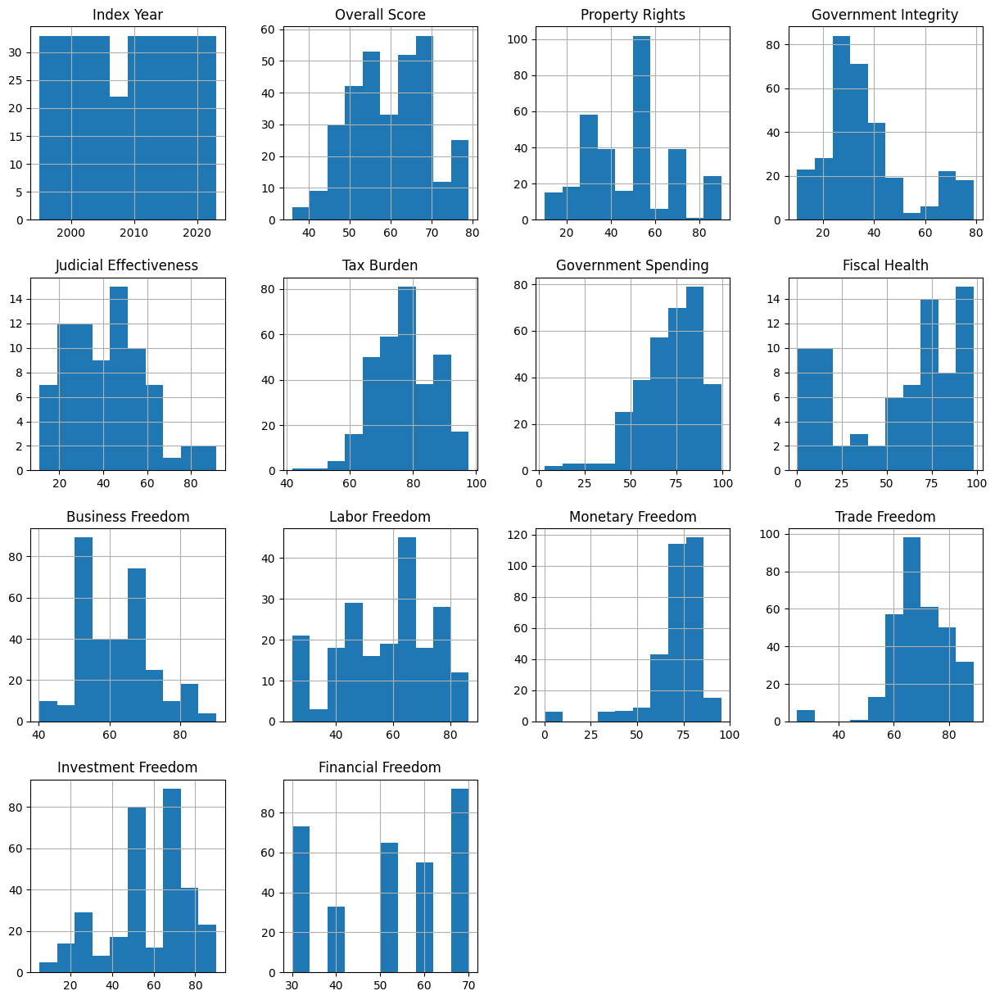

In [41]:
mercosur_data.hist(figsize=(15,15))

In [50]:
profile = ProfileReport(mercosur_data)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<iframe width="100%" height="800px" srcdoc="<!doctype html><html lang=en><head><meta charset=utf-8><meta name=viewport content="width=device-width, initial-scale=1, shrink-to-fit=no"><meta name=description content="Profile report generated by YData! Visit us at https://ydata.ai"><meta name=author content="YData and the open source community."><meta name=generator content="Pandas Profiling vv3.5.0"><meta name=url content=https://github.com/ydataai/pandas-profiling><meta name=date content="2023-02-10 12:07:06.663597"><title>Pandas Profiling Report</title><style>
/*!
 * Bootstrap v3.3.7 (http://getbootstrap.com)
 * Copyright 2011-2016 Twitter, Inc.
 * Licensed under MIT (https://github.com/twbs/bootstrap/blob/master/LICENSE)
 *//*! normalize.css v3.0.3 | MIT License | github.com/necolas/normalize.css */html{font-family:sans-serif;-webkit-text-size-adjust:100%;-ms-text-size-adjust:100%}body{margin:0}article,aside,details,figcaption,figure,footer,header,hgroup,main,menu,nav,section,summary{display:block}audio,canvas,progress,video{display:inline-block;vertical-align:baseline}audio:not([controls]){display:none;height:0}[hidden],template{display:none}a{background-color:transparent}a:active,a:hover{outline:0}abbr[title]{border-bottom:1px dotted}b,strong{font-weight:700}dfn{font-style:italic}h1{margin:.67em 0;font-size:2em}mark{color:#000;background:#ff0}small{font-size:80%}sub,sup{position:relative;font-size:75%;line-height:0;vertical-align:baseline}sup{top:-.5em}sub{bottom:-.25em}img{border:0}svg:not(:root){overflow:hidden}figure{margin:1em 40px}hr{height:0;-webkit-box-sizing:content-box;-moz-box-sizing:content-box;box-sizing:content-box}pre{overflow:auto}code,kbd,pre,samp{font-family:monospace,monospace;font-size:1em}button,input,optgroup,select,textarea{margin:0;font:inherit;color:inherit}button{overflow:visible}button,select{text-transform:none}button,html input[type=button],input[type=reset],input[type=submit]{-webkit-appearance:button;cursor:pointer}button[disabled],html input[disabled]{cursor:default}button::-moz-focus-inner,input::-moz-focus-inner{padding:0;border:0}input{line-height:normal}input[type=checkbox],input[type=radio]{-webkit-box-sizing:border-box;-moz-box-sizing:border-box;box-sizing:border-box;padding:0}input[type=number]::-webkit-inner-spin-button,input[type=number]::-webkit-outer-spin-button{height:auto}input[type=search]{-webkit-box-sizing:content-box;-moz-box-sizing:content-box;box-sizing:content-box;-webkit-appearance:textfield}input[type=search]::-webkit-search-cancel-button,input[type=search]::-webkit-search-decoration{-webkit-appearance:none}fieldset{padding:.35em .625em .75em;margin:0 2px;border:1px solid silver}legend{padding:0;border:0}textarea{overflow:auto}optgroup{font-weight:700}table{border-spacing:0;border-collapse:collapse}td,th{padding:0}/*! Source: https://github.com/h5bp/html5-boilerplate/blob/master/src/css/main.css */@media print{*,:after,:before{color:#000!important;text-shadow:none!important;background:0 0!important;-webkit-box-shadow:none!important;box-shadow:none!important}a,a:visited{text-decoration:underline}a[href]:after{content:" (" attr(href) ")"}abbr[title]:after{content:" (" attr(title) ")"}a[href^="javascript:"]:after,a[href^="#"]:after{content:""}blockquote,pre{border:1px solid #999;page-break-inside:avoid}thead{display:table-header-group}img,tr{page-break-inside:avoid}img{max-width:100%!important}h2,h3,p{orphans:3;widows:3}h2,h3{page-break-after:avoid}.navbar{display:none}.btn>.caret,.dropup>.btn>.caret{border-top-color:#000!important}.label{border:1px solid #000}.table{border-collapse:collapse!important}.table td,.table th{background-color:#fff!important}.table-bordered td,.table-bordered th{border:1px solid #ddd!important}}@font-face{font-family:'Glyphicons Halflings';src:url(../fonts/glyphicons-halflings-regular.eot);src:url(../fonts/glyphicons-halflings-regular.eot?#iefix) format('embedded-opentype'),url(../fonts/glyphicons-halflings-regular.woff2) format('woff2'),url(../fo

<class 'pandas_profiling.profile_report.ProfileReport'>.__repr__ returned empty string

<iframe width="100%" height="800px" srcdoc="<!doctype html><html lang=en><head><meta charset=utf-8><meta name=viewport content="width=device-width, initial-scale=1, shrink-to-fit=no"><meta name=description content="Profile report generated by YData! Visit us at https://ydata.ai"><meta name=author content="YData and the open source community."><meta name=generator content="Pandas Profiling vv3.5.0"><meta name=url content=https://github.com/ydataai/pandas-profiling><meta name=date content="2023-02-10 12:07:06.663597"><title>Pandas Profiling Report</title><style>
/*!
 * Bootstrap v3.3.7 (http://getbootstrap.com)
 * Copyright 2011-2016 Twitter, Inc.
 * Licensed under MIT (https://github.com/twbs/bootstrap/blob/master/LICENSE)
 *//*! normalize.css v3.0.3 | MIT License | github.com/necolas/normalize.css */html{font-family:sans-serif;-webkit-text-size-adjust:100%;-ms-text-size-adjust:100%}body{margin:0}article,aside,details,figcaption,figure,footer,header,hgroup,main,menu,nav,section,summary{display:block}audio,canvas,progress,video{display:inline-block;vertical-align:baseline}audio:not([controls]){display:none;height:0}[hidden],template{display:none}a{background-color:transparent}a:active,a:hover{outline:0}abbr[title]{border-bottom:1px dotted}b,strong{font-weight:700}dfn{font-style:italic}h1{margin:.67em 0;font-size:2em}mark{color:#000;background:#ff0}small{font-size:80%}sub,sup{position:relative;font-size:75%;line-height:0;vertical-align:baseline}sup{top:-.5em}sub{bottom:-.25em}img{border:0}svg:not(:root){overflow:hidden}figure{margin:1em 40px}hr{height:0;-webkit-box-sizing:content-box;-moz-box-sizing:content-box;box-sizing:content-box}pre{overflow:auto}code,kbd,pre,samp{font-family:monospace,monospace;font-size:1em}button,input,optgroup,select,textarea{margin:0;font:inherit;color:inherit}button{overflow:visible}button,select{text-transform:none}button,html input[type=button],input[type=reset],input[type=submit]{-webkit-appearance:button;cursor:pointer}button[disabled],html input[disabled]{cursor:default}button::-moz-focus-inner,input::-moz-focus-inner{padding:0;border:0}input{line-height:normal}input[type=checkbox],input[type=radio]{-webkit-box-sizing:border-box;-moz-box-sizing:border-box;box-sizing:border-box;padding:0}input[type=number]::-webkit-inner-spin-button,input[type=number]::-webkit-outer-spin-button{height:auto}input[type=search]{-webkit-box-sizing:content-box;-moz-box-sizing:content-box;box-sizing:content-box;-webkit-appearance:textfield}input[type=search]::-webkit-search-cancel-button,input[type=search]::-webkit-search-decoration{-webkit-appearance:none}fieldset{padding:.35em .625em .75em;margin:0 2px;border:1px solid silver}legend{padding:0;border:0}textarea{overflow:auto}optgroup{font-weight:700}table{border-spacing:0;border-collapse:collapse}td,th{padding:0}/*! Source: https://github.com/h5bp/html5-boilerplate/blob/master/src/css/main.css */@media print{*,:after,:before{color:#000!important;text-shadow:none!important;background:0 0!important;-webkit-box-shadow:none!important;box-shadow:none!important}a,a:visited{text-decoration:underline}a[href]:after{content:" (" attr(href) ")"}abbr[title]:after{content:" (" attr(title) ")"}a[href^="javascript:"]:after,a[href^="#"]:after{content:""}blockquote,pre{border:1px solid #999;page-break-inside:avoid}thead{display:table-header-group}img,tr{page-break-inside:avoid}img{max-width:100%!important}h2,h3,p{orphans:3;widows:3}h2,h3{page-break-after:avoid}.navbar{display:none}.btn>.caret,.dropup>.btn>.caret{border-top-color:#000!important}.label{border:1px solid #000}.table{border-collapse:collapse!important}.table td,.table th{background-color:#fff!important}.table-bordered td,.table-bordered th{border:1px solid #ddd!important}}@font-face{font-family:'Glyphicons Halflings';src:url(../fonts/glyphicons-halflings-regular.eot);src:url(../fonts/glyphicons-halflings-regular.eot?#iefix) format('embedded-opentype'),url(../fonts/glyphicons-halflings-regular.woff2) format('woff2'),url(../fo